<a href="https://colab.research.google.com/github/Gulzamanshaikh/Datavisualization_PGD/blob/main/DL_Project_YOLO_OD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Object Detection Using YOLOv8 in Python**

PGD in Data Science and Artificial Intelligence - Deep Learning

Submitted by: Gul Zaman Shaikh

Date: October 6, 2024

# **Abstract**
This project focuses on implementing an object detection system using the YOLOv8 (You Only Look Once) model in Python. The system is capable of detecting objects in both images and videos, leveraging GPU acceleration when available for enhanced performance. The project utilizes various libraries such as PyTorch, OpenCV, and Ultralytics to build an efficient and user-friendly application.


# **Introduction**
**What is Object Detection?**

Object detection is a computer vision technique that identifies and locates objects within an image or video. Unlike image classification, which only identifies the presence of an object, object detection provides the exact coordinates of the object in the frame.

**Importance and Applications**

Object detection has numerous applications, including:

**Autonomous Vehicles:** Detecting pedestrians, other vehicles, and obstacles.

**Surveillance:** Monitoring activities and identifying suspicious behavior.

**Healthcare:** Assisting in medical imaging analysis.

**Retail:** Managing inventory and enhancing customer experience.


**Objectives**

**Implement Object Detection:** Utilize the YOLOv8 model to detect objects in images and videos.

**Support Multiple Media Types:** Enable detection on both static images and dynamic video streams.

**Optimize Performance:** Use GPU acceleration when available to speed up the detection process.

**User-Friendly Interface:** Provide an easy way for users to upload files and view results.

**Tools and Technologies**

**Python:** The primary programming language used for implementation.

**PyTorch:** A deep learning framework used for model training and deployment.

**Ultralytics YOLOv8:** A state-of-the-art object detection model.

**OpenCV:** A library for image and video processing.

**Matplotlib:** Used for displaying images and results.

**Google Colab:** An online platform to run and share the code.

# **Methodology**
1. **Setting Up the Environment**

**Check for GPU Availability:** Determine if CUDA (GPU acceleration) is available to enhance performance.

**Install Necessary Libraries:** Use pip to install Ultralytics, ipywidgets, matplotlib, and OpenCV.

2. **Loading the YOLOv8 Model**

**Model Selection:** Load the YOLOv8 model (e.g., yolov8n.pt for the nano version) based on user preference.

**Device Allocation:** Assign the model to GPU if available; otherwise, use CPU.
3. **Image Processing and Prediction**

**Image Upload:** Allow users to upload an image file.

**Image Validation:** Ensure the uploaded file is a valid image format.

**Resize Image:** Adjust the image size for better display and processing.

**Perform Prediction:** Use the YOLOv8 model to detect objects in the image.

**Draw Bounding Boxes:** Highlight detected objects with bounding boxes and labels.
4. **Video Processing**

**Video Upload:** Allow users to upload a video file.

**Video Validation:** Ensure the uploaded file is a valid video format.

**Frame-by-Frame Detection:** Process each frame of the video to detect objects.

**Display and Save Results:** Show the processed video with detections and save the output.


# **Implementation**

# **Key Functions and Modules**

# **1. Environment Setup:**



```
# import torch
if torch.cuda.is_available():
    print("CUDA is available. GPU will be used.")
else:
    print("CUDA is not available. Using CPU.")
```

Checks for GPU availability to optimize performance.


In [4]:
import torch
if torch.cuda.is_available():
    print("CUDA is available. GPU will be used.")
else:
    print("CUDA is not available. Using CPU.")



CUDA is not available. Using CPU.


2. Installing Libraries:



```
# !pip install ultralytics
!pip install ipywidgets
!pip install matplotlib
!pip install opencv-python-headless

```

Installs necessary Python libraries for the project.

In [5]:
!pip install ultralytics
!pip install ipywidgets
!pip install matplotlib
!pip install opencv-python-headless



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.8/882.8 kB 13.8 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)


# **Installing remaining libraries**

In [6]:
import ipywidgets as widgets
from IPython.display import display
import torch
import cv2
import numpy as np
import os
import time
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab import files
from IPython.display import display, clear_output
from ultralytics import settings

# View all settings
print(settings)

# Return a specific setting
value = settings["runs_dir"]



Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
JSONDict("/root/.config/Ultralytics/settings.json"):
{
  "settings_version": "0.0.6",
  "datasets_dir": "/content/datasets",
  "weights_dir": "weights",
  "runs_dir": "runs",
  "uuid": "569f3ba64b326db489132663f79cd37279811de477381b83ac131e6cdd129cbb",
  "sync": true,
  "api_key": "",
  "openai_api_key": "",
  "clearml": true,
  "comet": true,
  "dvc": true,
  "hub": true,
  "mlflow": true,
  "neptune": true,
  "raytune": true,
  "tensorboard": true,
  "wandb": true,
  "vscode_msg": true
}


 **3. Loading the YOLOv8 Model:**

In [7]:
def load_model(model_name, device="cpu"):
    try:
        if model_name.lower() == "yolov8":
            model = YOLO('yolov8n.pt')  # You can change to yolov8s.pt, yolov8m.pt, etc.
        else:
            model_path = f'./{model_name.lower()}.pt'
            if os.path.exists(model_path):
                model = YOLO(model_path)
            else:
                print(f"Model {model_name} not found.")
                return None

        if device.lower() in ['gpu', 'cuda'] and torch.cuda.is_available():
            model.to('cuda')
            print("Model loaded on GPU.")
        else:
            model.to('cpu')
            print("Model loaded on CPU.")

        return model

    except Exception as e:
        print(f"Error loading model: {e}")
        return None

# --- Utility: Resize Image ---
def resize_image(image, height):
    aspect_ratio = image.shape[1] / image.shape[0]  # width / height
    new_width = int(height * aspect_ratio)
    return cv2.resize(image, (new_width, height))

# --- Perform Prediction ---
def predict(model, img, conf_thresh=0.5):
    results = model.predict(img, conf=conf_thresh)
    return results

# --- Draw Bounding Boxes ---
def draw_boxes(img, results, conf_thresh=0.5, thickness=2, font_scale=0.5):
    detected_objects = []
    for result in results:
        for box in result.boxes:
            # Extract bounding box coordinates
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().astype(int)
            conf = box.conf[0].cpu().numpy().astype(float)
            class_id = int(box.cls[0].cpu().numpy())
            if conf >= conf_thresh:
                # Draw rectangle for bounding box
                colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (255, 0, 255), (0, 255, 255)]
                color = colors[class_id % len(colors)]
                cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)
                label = f"{result.names[class_id]}: {conf:.2f}"
                cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, font_scale, color, thickness)
                detected_objects.append(result.names[class_id])
    return img, detected_objects

# --- Display Image ---
def display_image(img, title="Image"):
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis('off')
    plt.show()



**4. Image Detection:**

In [8]:
def run_object_detection():
    # Determine device
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")

    # Load YOLO model
    version = "yolov8"  # Change as needed (e.g., 'yolov8s', 'yolov8m', etc.)
    confidence_threshold = 0.5

    model = load_model(version, device)

    if not model:
        print("Failed to load the model. Please check the model name and try again.")
        return

    # Upload image
    print("Please upload an image file for object detection:")
    uploaded = files.upload()

    if not uploaded:
        print("No file uploaded.")
        return

    # Get the uploaded file name
    file_name = next(iter(uploaded))
    print(f"Uploaded file: {file_name}")

    try:
        # Check if uploaded file is an image
        if not file_name.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
            print("The uploaded file is not an image. Please upload a valid image file.")
            return

        # Read the image file
        image_data = uploaded[file_name]
        nparr = np.frombuffer(image_data, np.uint8)
        img = cv2.imdecode(nparr, cv2.IMREAD_COLOR)

        if img is None:
            print("Failed to read the image. Please upload a valid image file.")
            return

        # Resize for display
        resized_img = resize_image(img, 500)

        # Perform prediction
        start_time = time.time()
        results = predict(model, resized_img, confidence_threshold)
        prediction_time = time.time() - start_time

        # Draw bounding boxes on the image
        output_img, detected_objects = draw_boxes(resized_img.copy(), results, confidence_threshold)

        # Display original and processed images
        print("Original Image:")
        display_image(resized_img, title="Original Image")
        print("Processed Image:")
        display_image(output_img, title=f"Processed Image - Prediction time: {prediction_time:.2f} seconds")

        # Display detected objects
        if detected_objects:
            print(f"Detected objects: {', '.join(detected_objects)}")
        else:
            print("No objects detected.")

    except Exception as e:
        print(f"An error occurred during processing: {e}")



**5. Video Detection:**

In [9]:
def run_video_object_detection(video_path, model, output_path="output.avi", conf_thresh=0.5):
    try:
        cap = cv2.VideoCapture(video_path)
        if not cap.isOpened():
            print("Error: Could not open video.")
            return

        # Get video properties
        frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        fps = int(cap.get(cv2.CAP_PROP_FPS))

        # Define codec and create VideoWriter object
        fourcc = cv2.VideoWriter_fourcc(*'XVID')
        out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

        while True:
            ret, frame = cap.read()
            if not ret:
                break

            # Perform prediction
            results = predict(model, frame, conf_thresh)

            # Draw bounding boxes on the frame
            output_frame, _ = draw_boxes(frame, results, conf_thresh)

            # Write the frame to the output video
            out.write(output_frame)

            # Display the resulting frame
            from google.colab.patches import cv2_imshow
            cv2_imshow(output_frame)
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break

        # Release everything if job is finished
        cap.release()
        out.release()

        print(f"Video saved to {output_path}")

    except Exception as e:
        print(f"An error occurred during video processing: {e}")

# Example usage for video detection
def run_video_demo():
    # Determine device
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"Using device: {device}")

    # Load YOLO model
    version = "yolov8"  # Change as needed (e.g., 'yolov8s', 'yolov8m', etc.)
    model = load_model(version, device)

    if not model:
        print("Failed to load the model. Please check the model name and try again.")
        return

    # Upload video
    print("Please upload a video file for object detection:")
    uploaded = files.upload()

    if not uploaded:
        print("No file uploaded.")
        return

    # Get the uploaded file name
    file_name = next(iter(uploaded))
    print(f"Uploaded file: {file_name}")

    try:
        # Check if uploaded file is a video
        if not file_name.lower().endswith(('.mp4', '.avi', '.mov', '.mkv')):
            print("The uploaded file is not a video. Please upload a valid video file.")
            return

        video_path = file_name
        output_path = "output_video.avi"

        run_video_object_detection(video_path, model, output_path)

    except Exception as e:
        print(f"An error occurred during processing: {e}")

**For image detection**


```
# run_object_detection()
```



Using device: cpu


100%|██████████| 6.25M/6.25M [00:00<00:00, 48.9MB/s]


Model loaded on CPU.
Please upload an image file for object detection:


Saving WhatsApp Image 2024-09-16 at 11.12.58_4364198a.jpg to WhatsApp Image 2024-09-16 at 11.12.58_4364198a.jpg
Uploaded file: WhatsApp Image 2024-09-16 at 11.12.58_4364198a.jpg

0: 384x640 4 persons, 1 chair, 3 laptops, 353.5ms
Speed: 14.7ms preprocess, 353.5ms inference, 24.2ms postprocess per image at shape (1, 3, 384, 640)
Original Image:


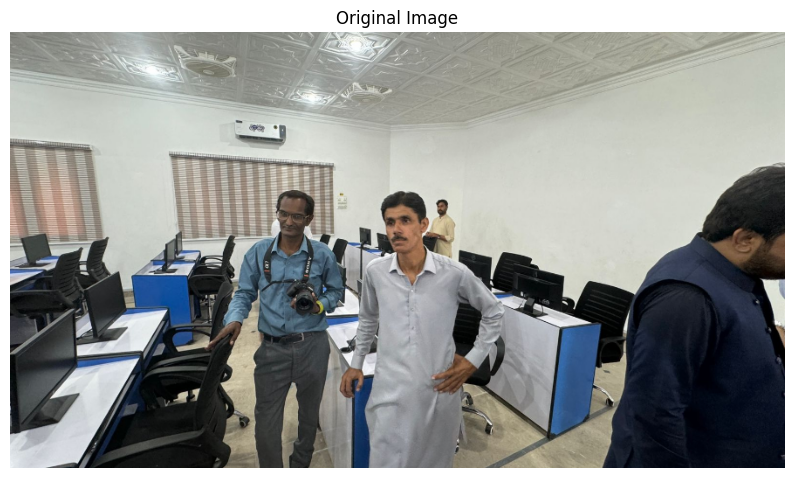

Processed Image:


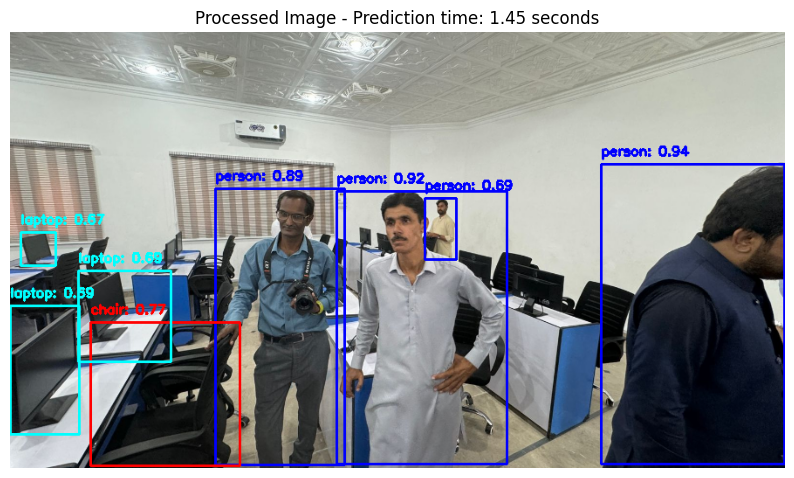

Detected objects: person, person, person, chair, person, laptop, laptop, laptop


In [10]:
run_object_detection()


# **Results**
**Image Detection**

**Original Image:** Displays the uploaded image without any modifications.

**Processed Image:** Shows the image with bounding boxes and labels around detected objects.

**Performance:** Reports the time taken to perform the detection.

**For video detection**


```
# run_video_demo()
```



Using device: cpu
Model loaded on CPU.
Please upload a video file for object detection:


Saving WhatsApp Video 2024-09-16 at 11.12.58_12b3c334.mp4 to WhatsApp Video 2024-09-16 at 11.12.58_12b3c334.mp4
Uploaded file: WhatsApp Video 2024-09-16 at 11.12.58_12b3c334.mp4

0: 384x640 5 persons, 211.9ms
Speed: 5.1ms preprocess, 211.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


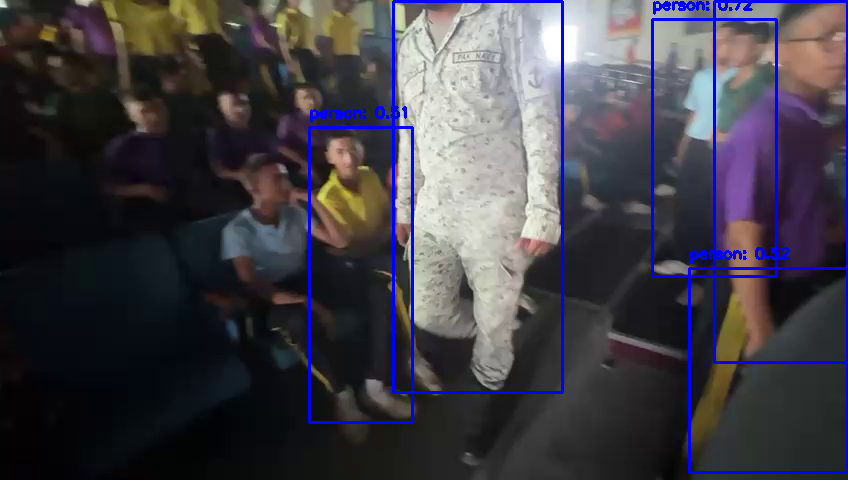


0: 384x640 3 persons, 221.6ms
Speed: 3.3ms preprocess, 221.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


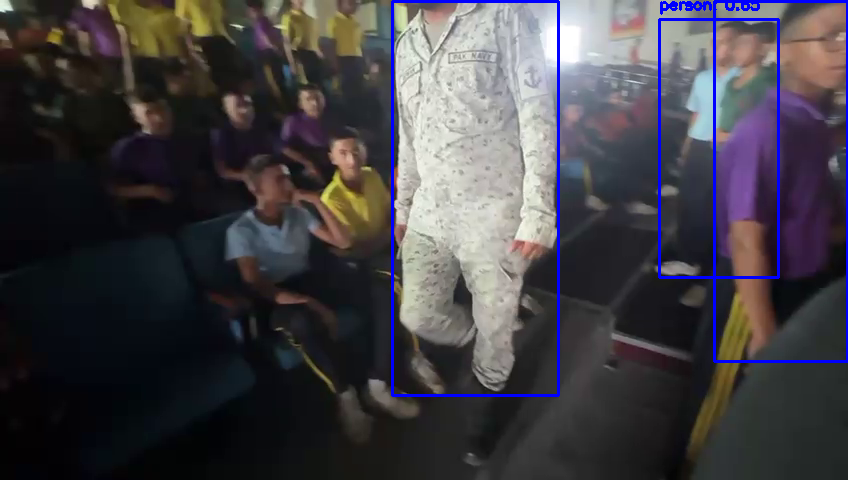


0: 384x640 3 persons, 264.9ms
Speed: 3.4ms preprocess, 264.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


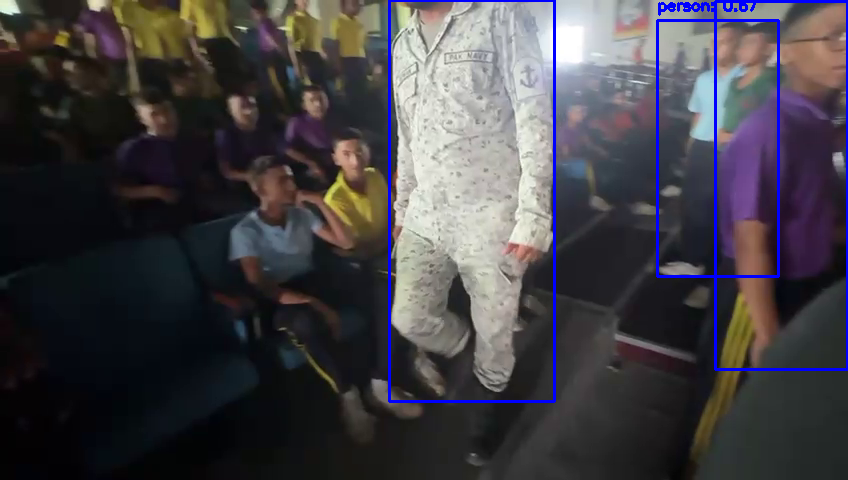


0: 384x640 3 persons, 212.1ms
Speed: 5.6ms preprocess, 212.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


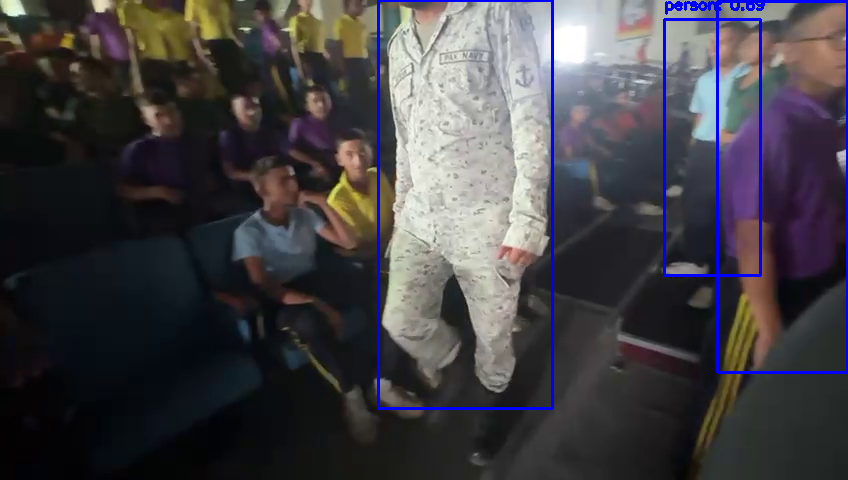


0: 384x640 4 persons, 241.3ms
Speed: 4.8ms preprocess, 241.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


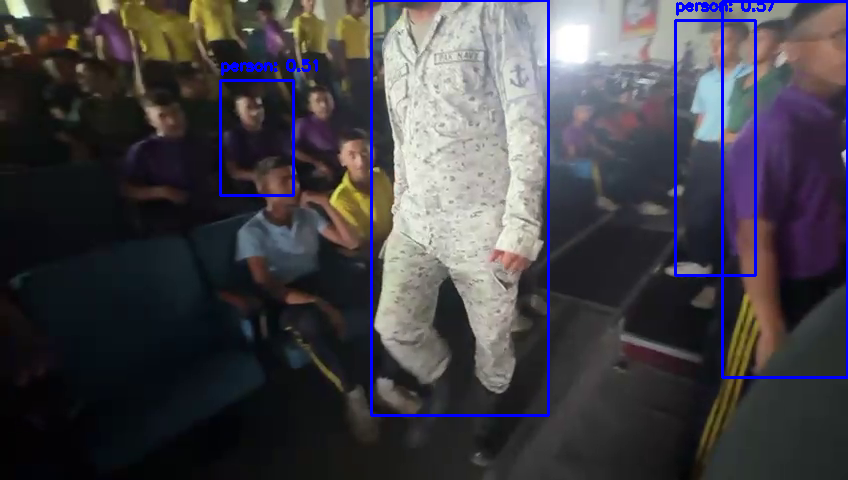


0: 384x640 3 persons, 258.4ms
Speed: 5.1ms preprocess, 258.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


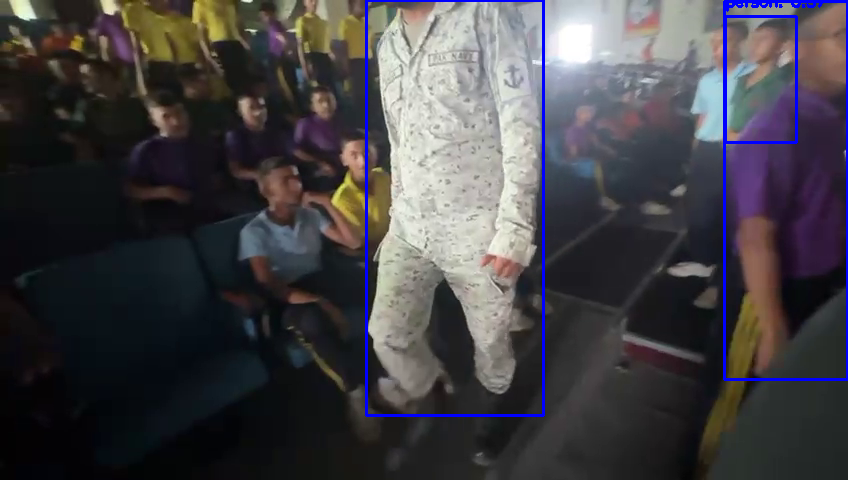


0: 384x640 5 persons, 230.3ms
Speed: 5.0ms preprocess, 230.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


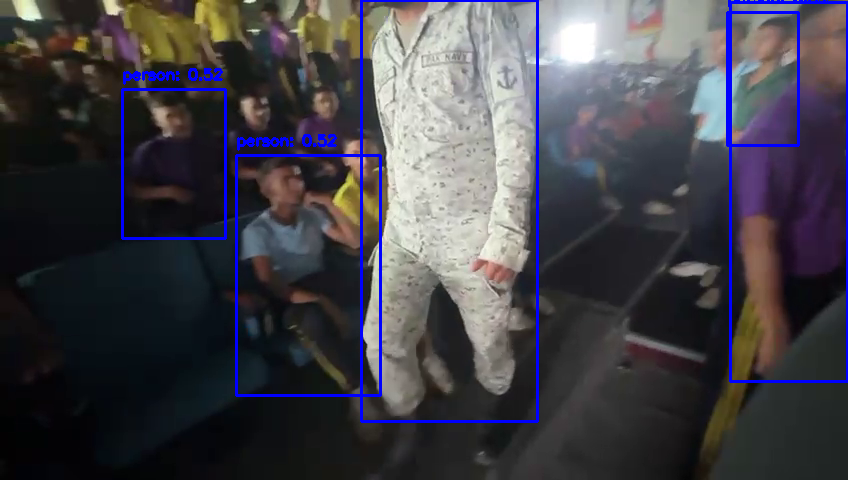


0: 384x640 5 persons, 208.8ms
Speed: 6.5ms preprocess, 208.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


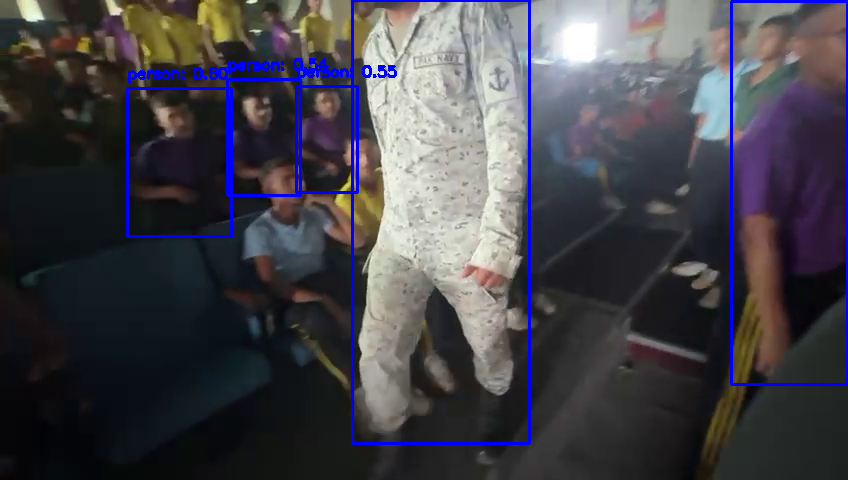


0: 384x640 8 persons, 225.3ms
Speed: 5.2ms preprocess, 225.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


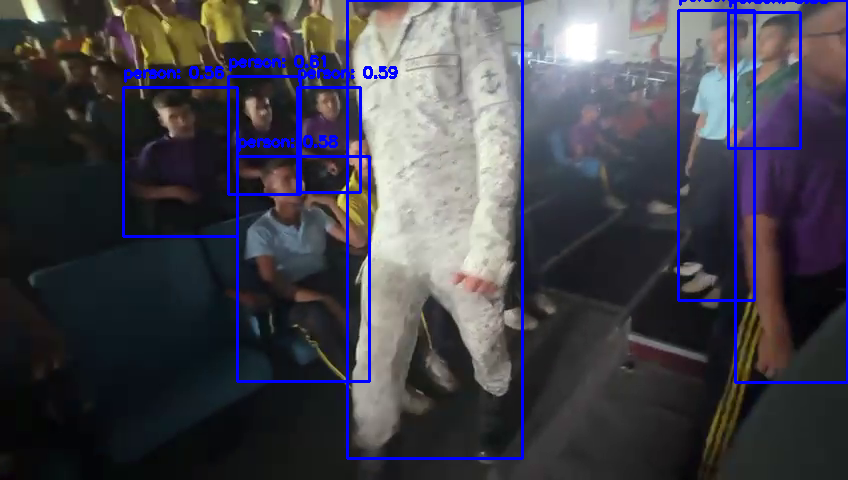


0: 384x640 5 persons, 247.9ms
Speed: 5.4ms preprocess, 247.9ms inference, 7.2ms postprocess per image at shape (1, 3, 384, 640)


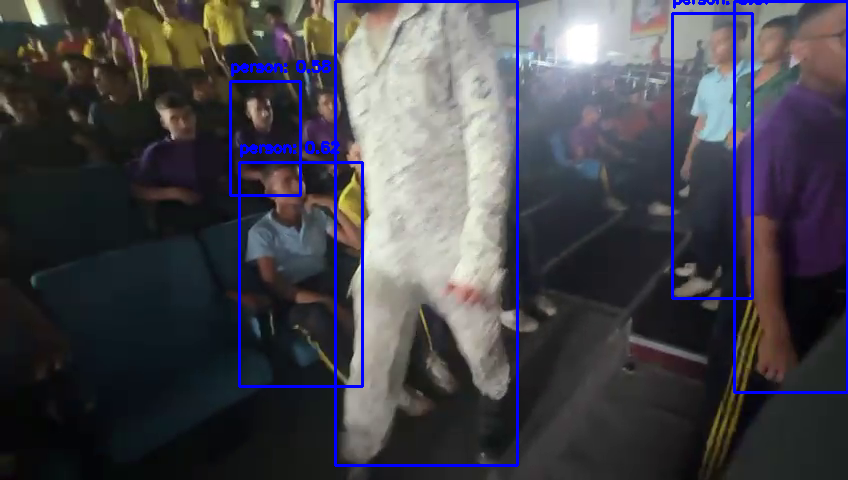


0: 384x640 7 persons, 208.3ms
Speed: 5.1ms preprocess, 208.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


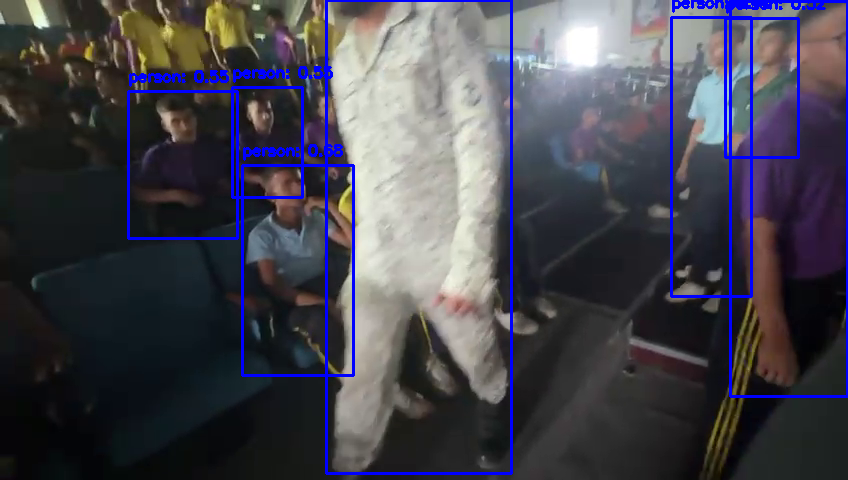


0: 384x640 5 persons, 205.0ms
Speed: 5.7ms preprocess, 205.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


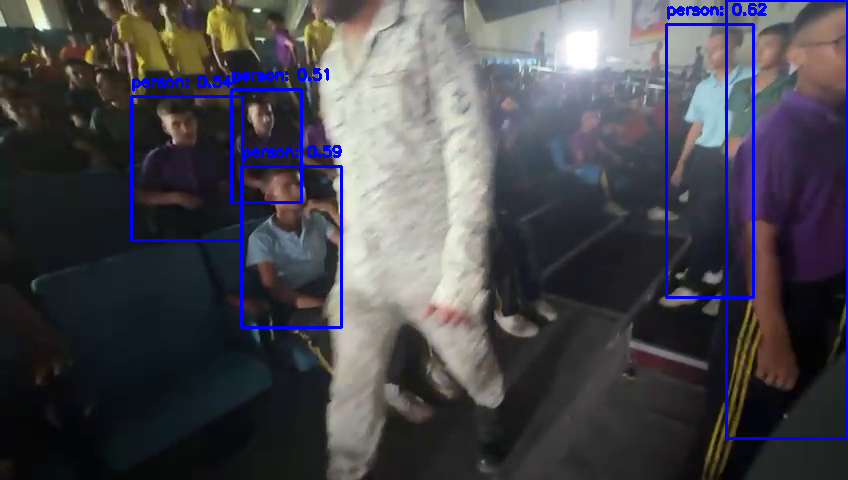


0: 384x640 5 persons, 209.5ms
Speed: 7.2ms preprocess, 209.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


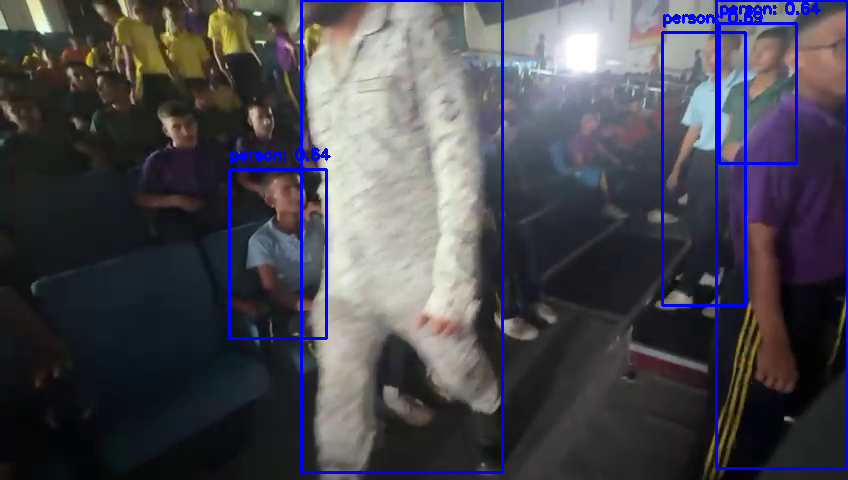


0: 384x640 5 persons, 200.6ms
Speed: 5.4ms preprocess, 200.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


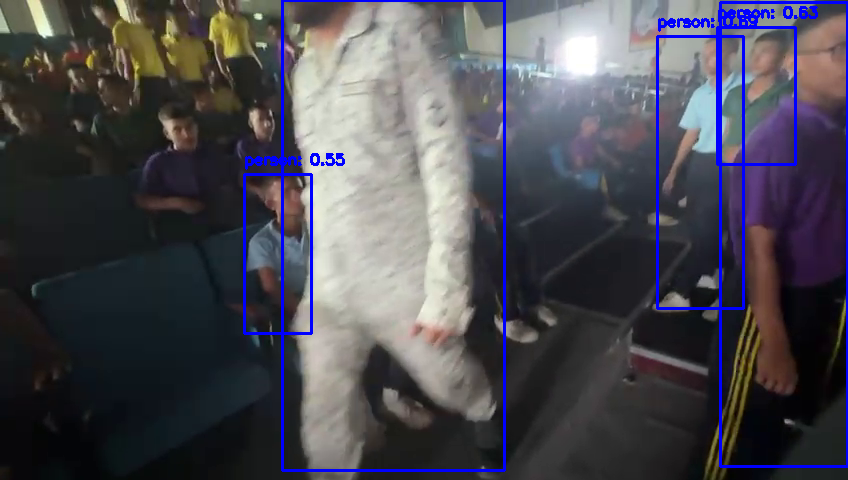


0: 384x640 4 persons, 205.1ms
Speed: 4.9ms preprocess, 205.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


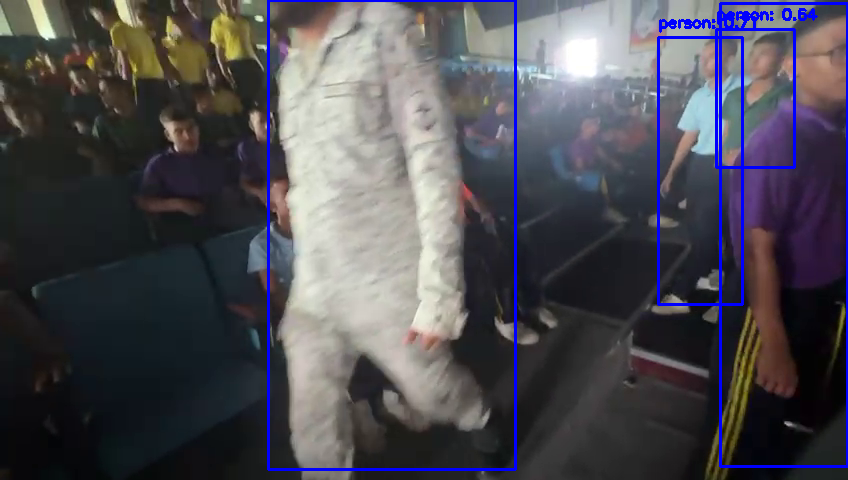


0: 384x640 4 persons, 217.8ms
Speed: 5.3ms preprocess, 217.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


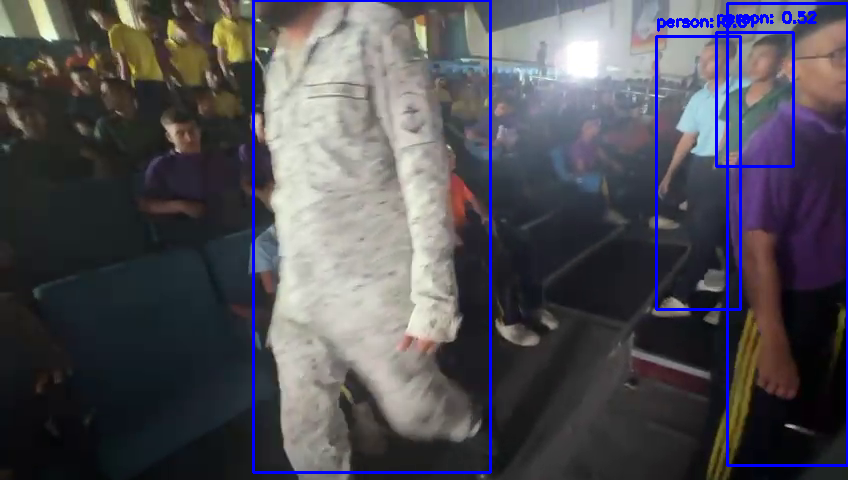


0: 384x640 4 persons, 203.4ms
Speed: 5.0ms preprocess, 203.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


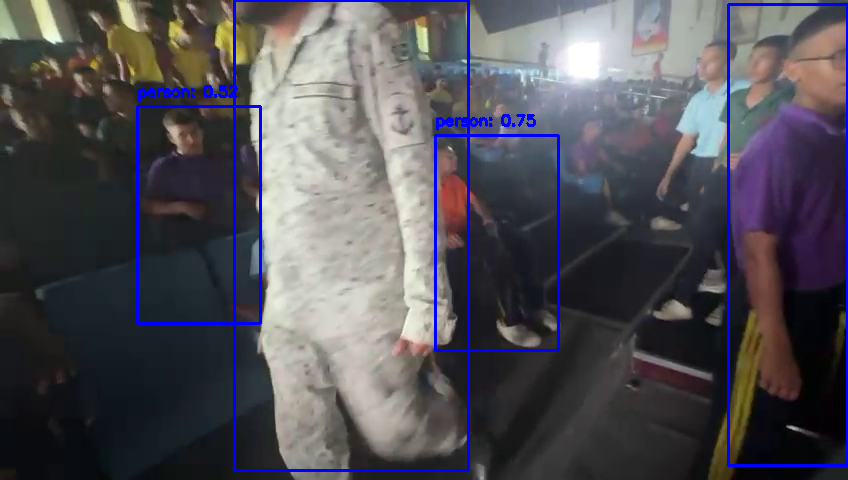


0: 384x640 3 persons, 214.9ms
Speed: 5.2ms preprocess, 214.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


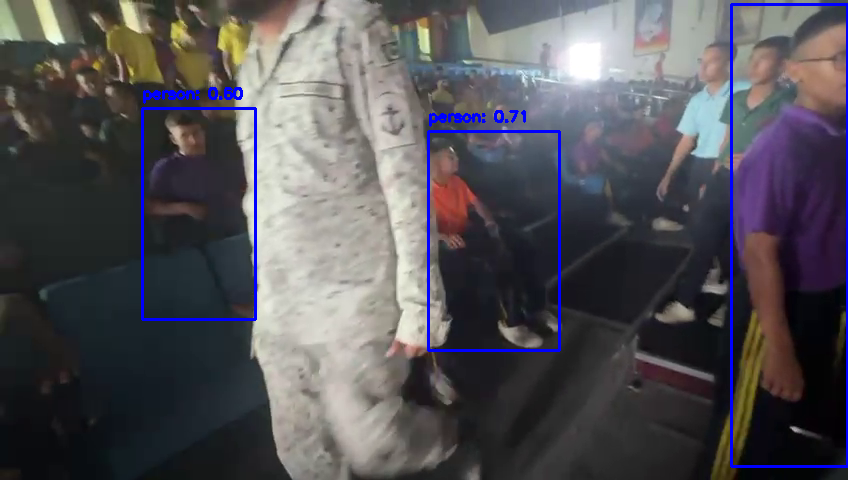


0: 384x640 3 persons, 218.3ms
Speed: 5.1ms preprocess, 218.3ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


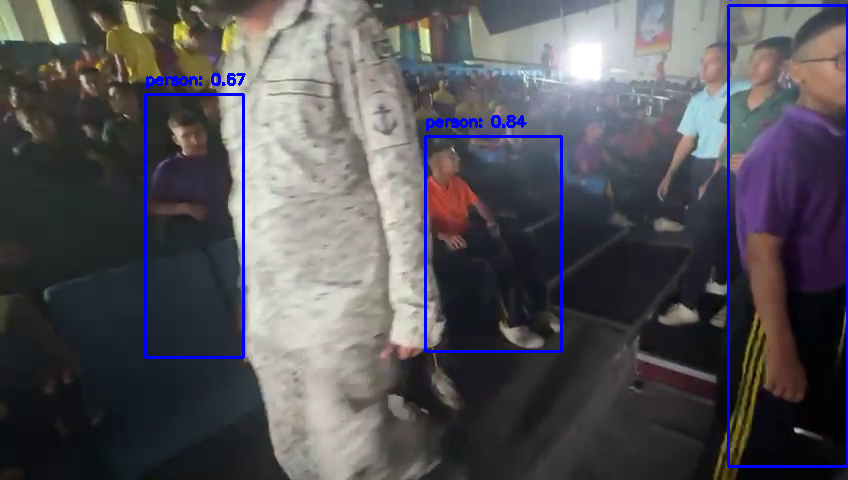


0: 384x640 5 persons, 202.9ms
Speed: 5.8ms preprocess, 202.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


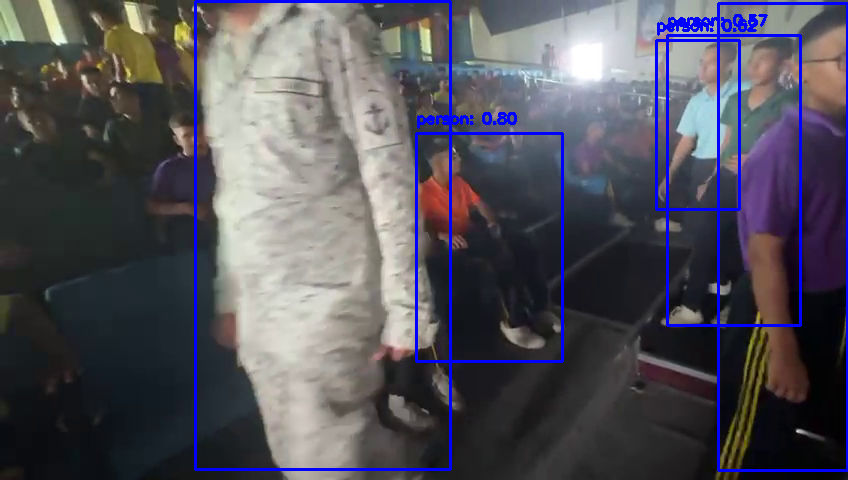


0: 384x640 3 persons, 210.8ms
Speed: 5.1ms preprocess, 210.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


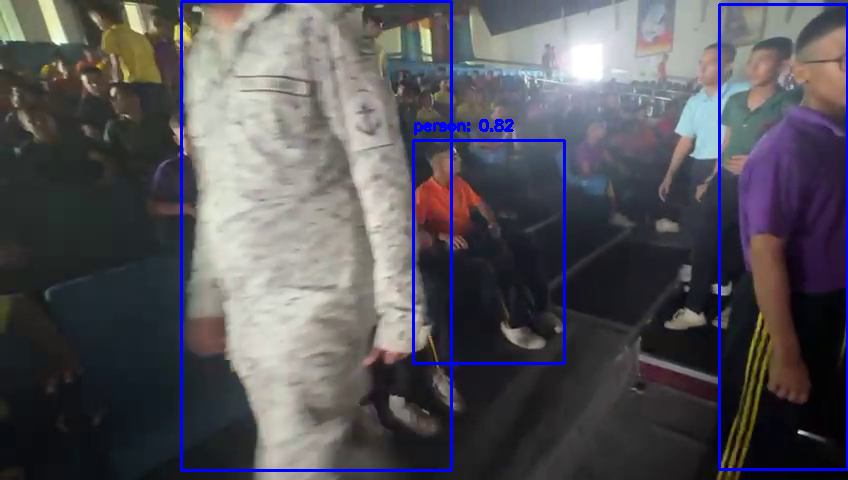


0: 384x640 4 persons, 204.5ms
Speed: 5.4ms preprocess, 204.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


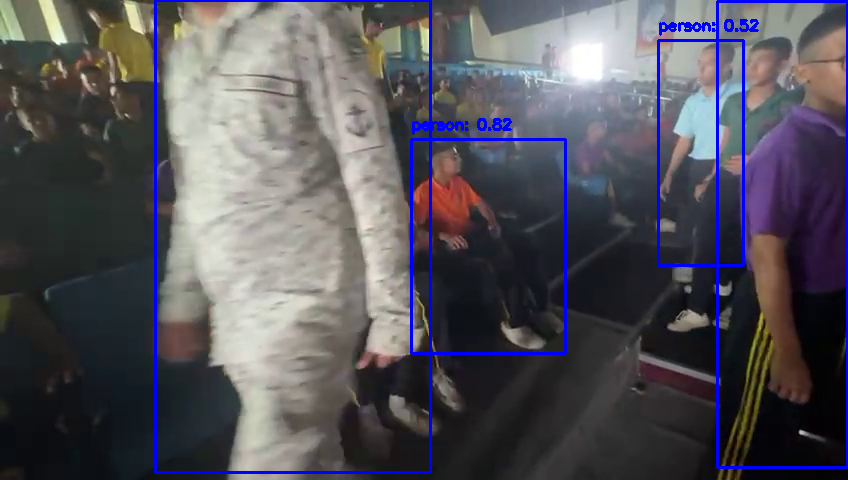


0: 384x640 5 persons, 222.9ms
Speed: 6.6ms preprocess, 222.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


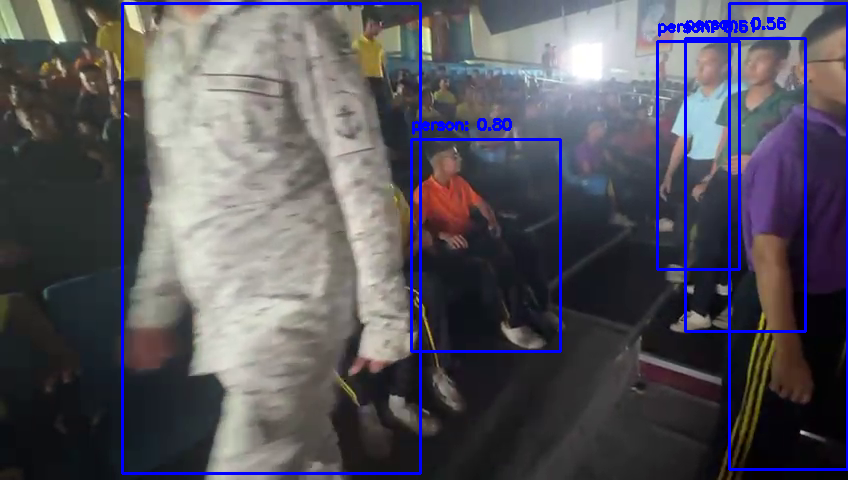


0: 384x640 4 persons, 207.5ms
Speed: 5.3ms preprocess, 207.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


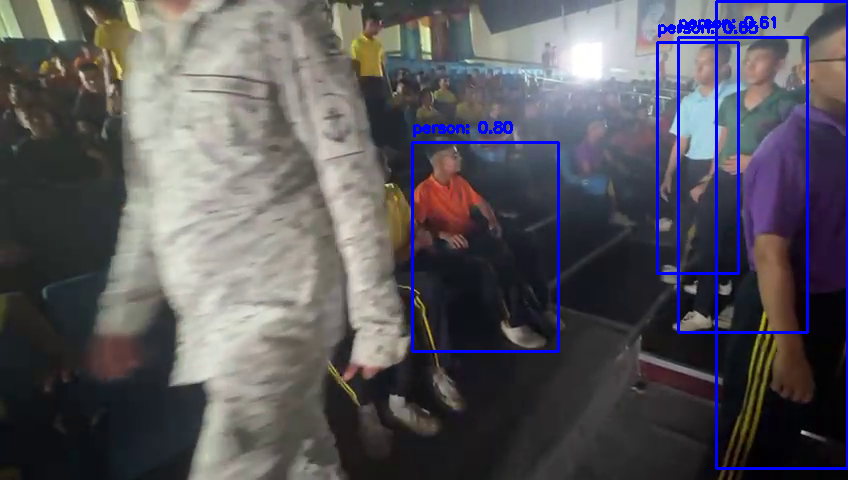


0: 384x640 4 persons, 213.1ms
Speed: 5.0ms preprocess, 213.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


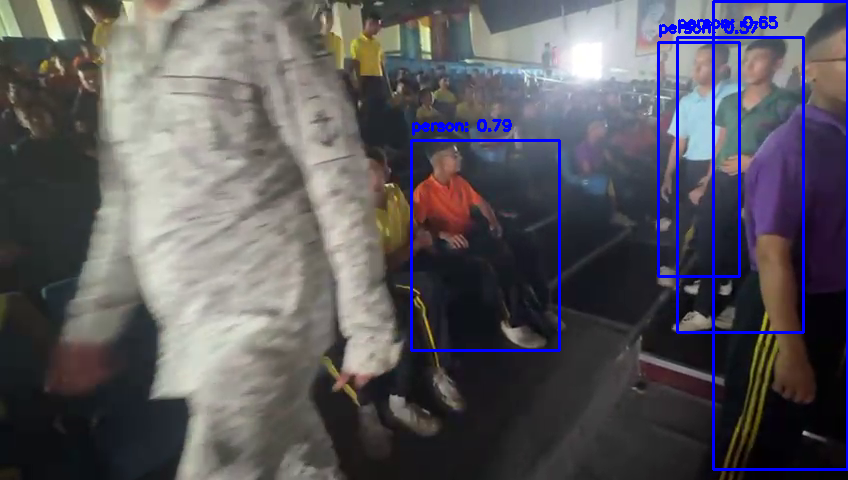


0: 384x640 3 persons, 214.7ms
Speed: 4.9ms preprocess, 214.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


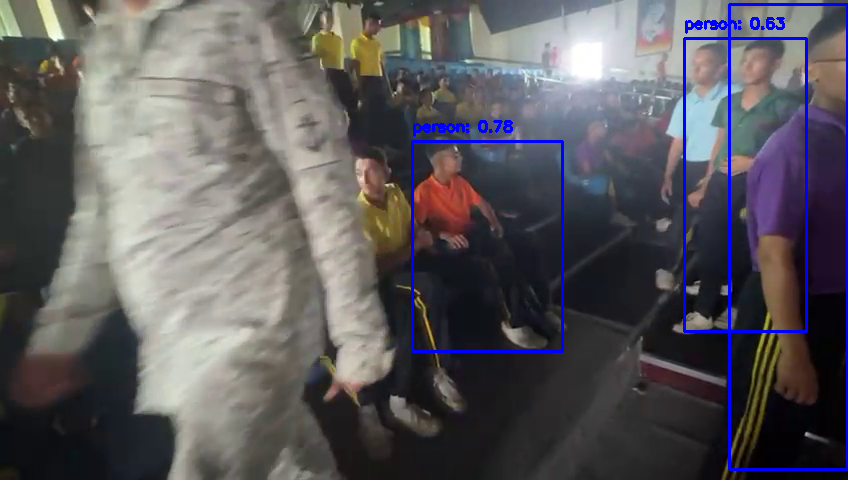


0: 384x640 4 persons, 203.6ms
Speed: 5.1ms preprocess, 203.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


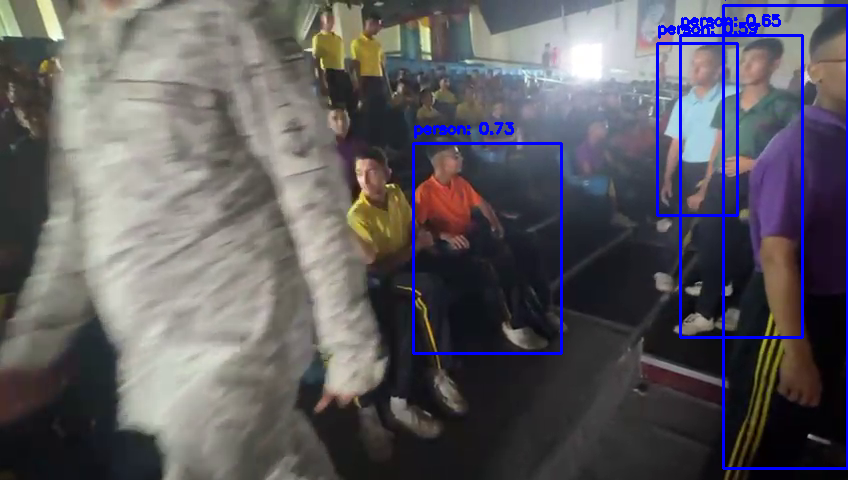


0: 384x640 4 persons, 1 elephant, 217.7ms
Speed: 5.2ms preprocess, 217.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


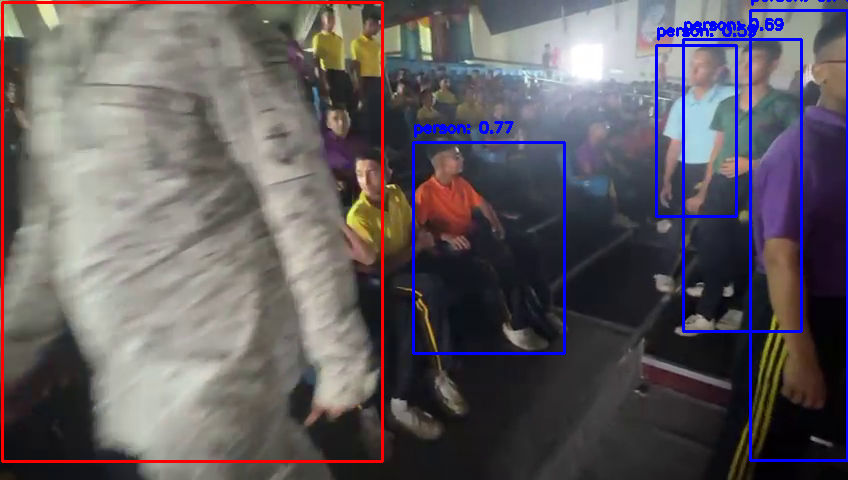


0: 384x640 5 persons, 216.8ms
Speed: 5.4ms preprocess, 216.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


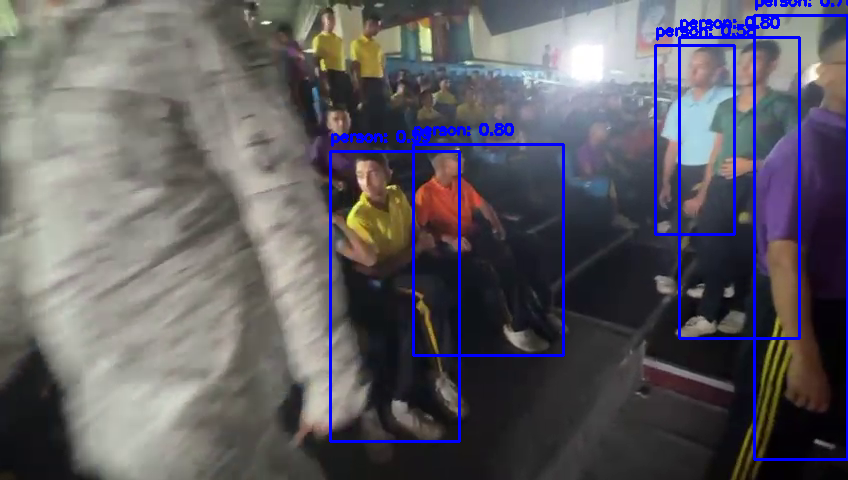


0: 384x640 5 persons, 202.7ms
Speed: 4.9ms preprocess, 202.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


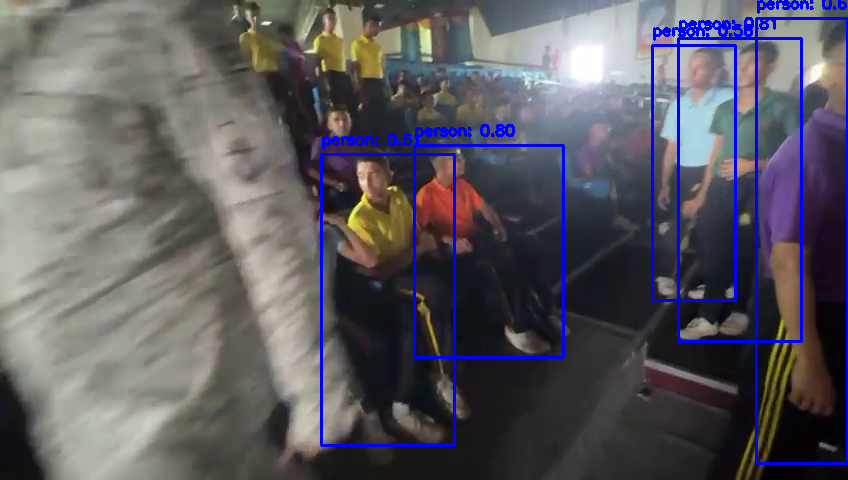


0: 384x640 4 persons, 207.3ms
Speed: 5.3ms preprocess, 207.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


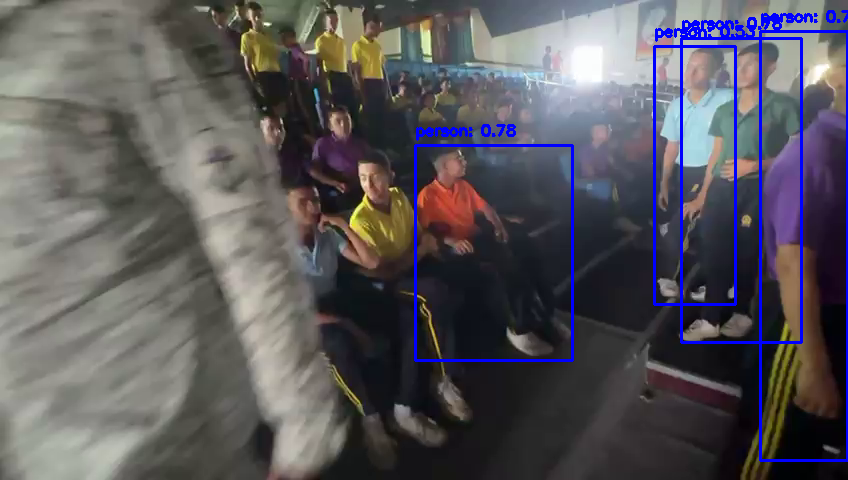


0: 384x640 5 persons, 214.1ms
Speed: 5.4ms preprocess, 214.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


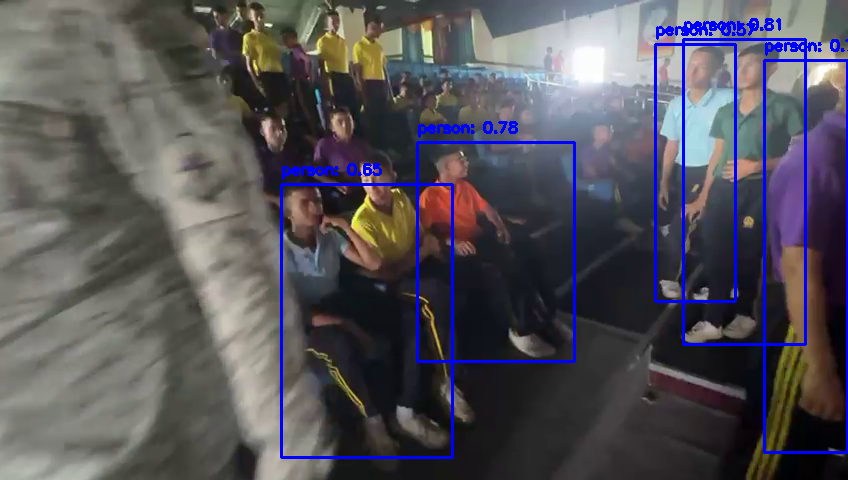


0: 384x640 6 persons, 206.4ms
Speed: 5.2ms preprocess, 206.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


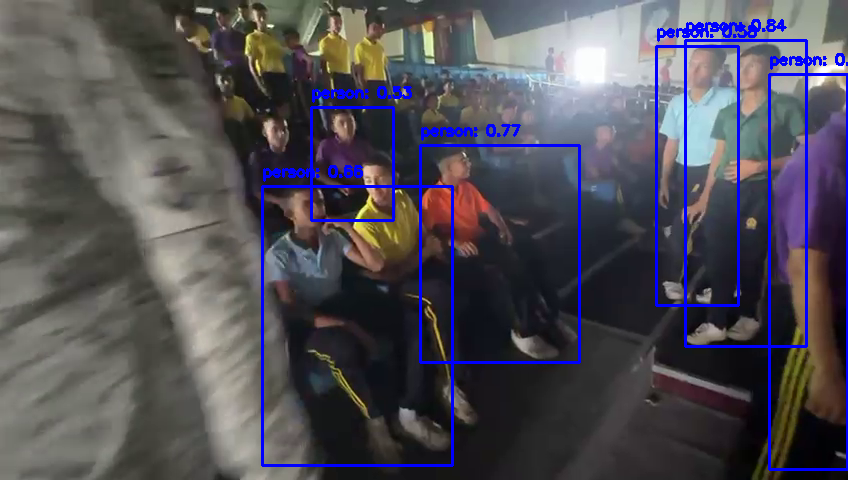


0: 384x640 6 persons, 205.7ms
Speed: 4.8ms preprocess, 205.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


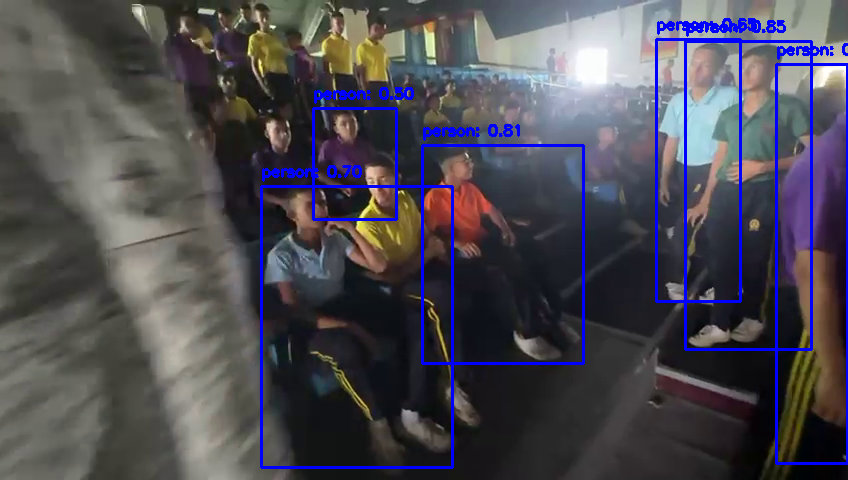


0: 384x640 6 persons, 201.9ms
Speed: 4.8ms preprocess, 201.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


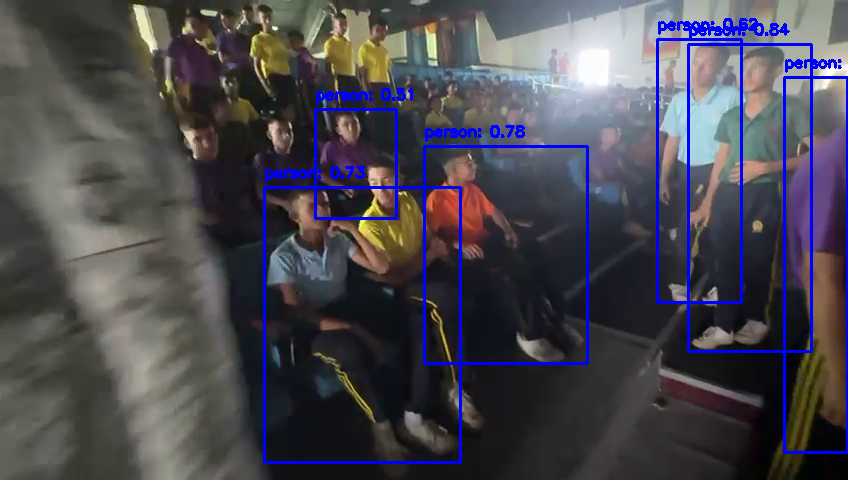


0: 384x640 5 persons, 210.7ms
Speed: 4.4ms preprocess, 210.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


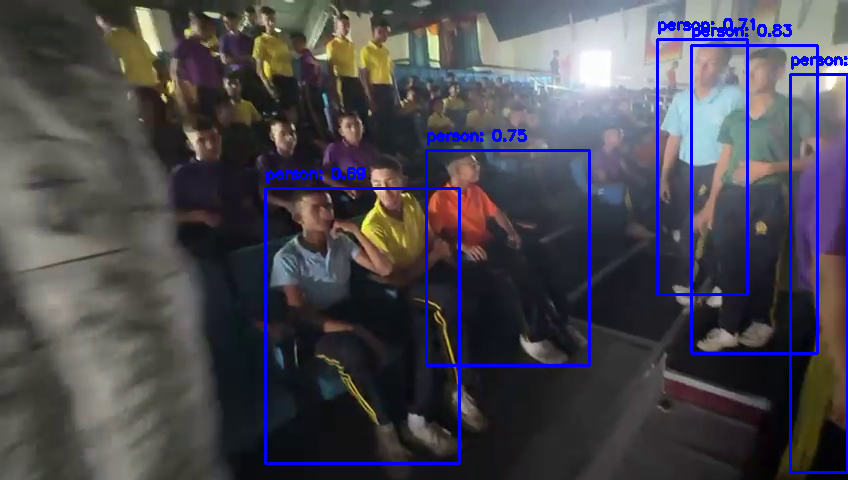


0: 384x640 4 persons, 200.3ms
Speed: 5.4ms preprocess, 200.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


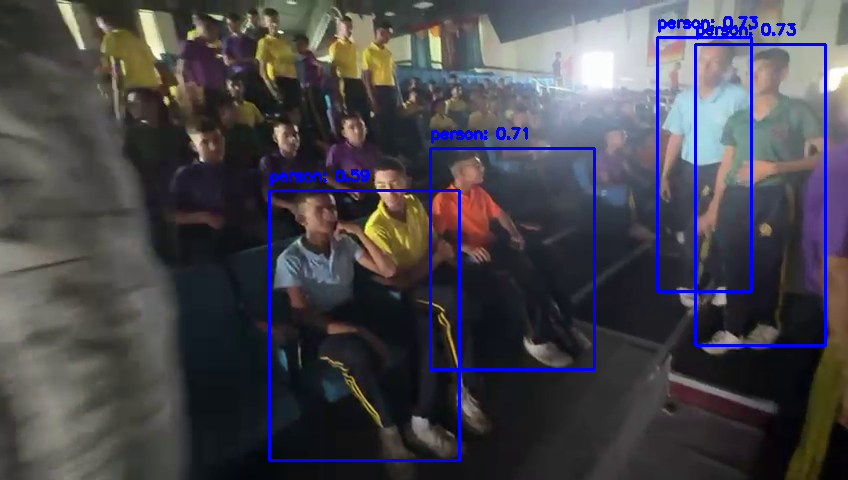


0: 384x640 5 persons, 201.6ms
Speed: 5.3ms preprocess, 201.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


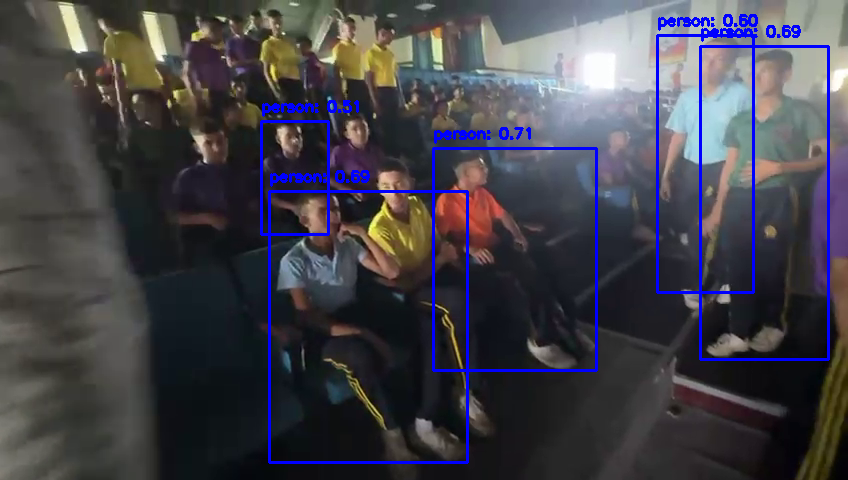


0: 384x640 5 persons, 239.5ms
Speed: 5.0ms preprocess, 239.5ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)


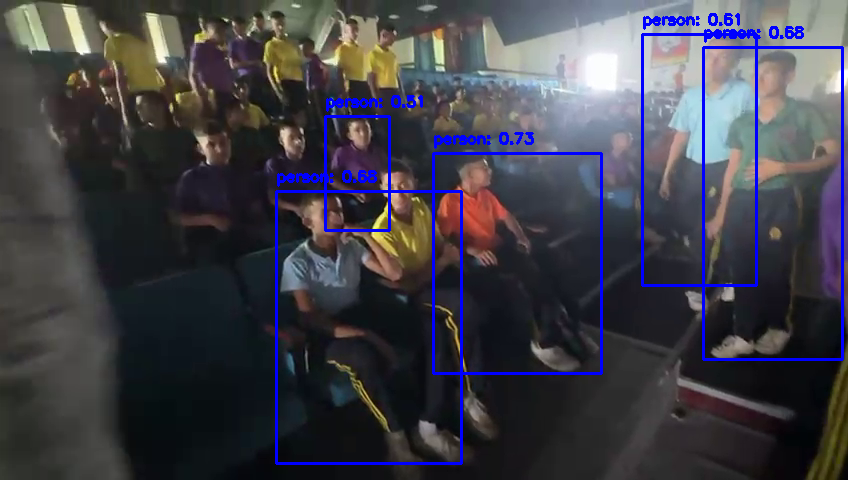


0: 384x640 5 persons, 212.5ms
Speed: 5.2ms preprocess, 212.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


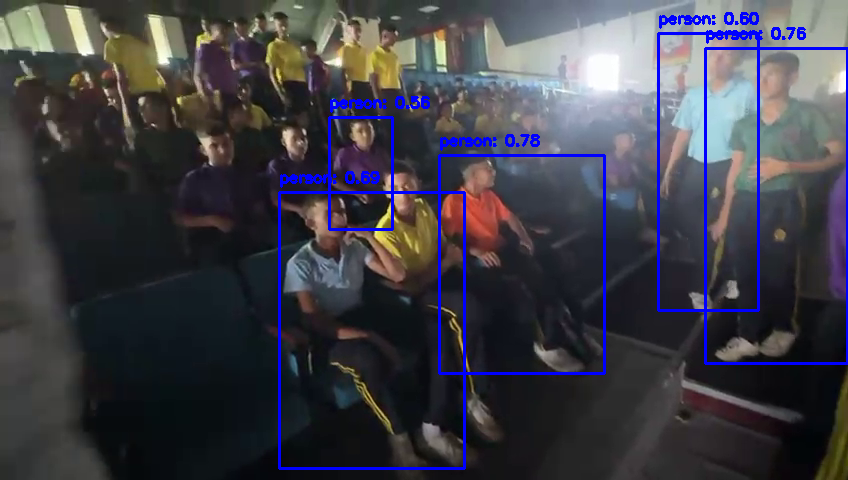


0: 384x640 4 persons, 225.9ms
Speed: 5.8ms preprocess, 225.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


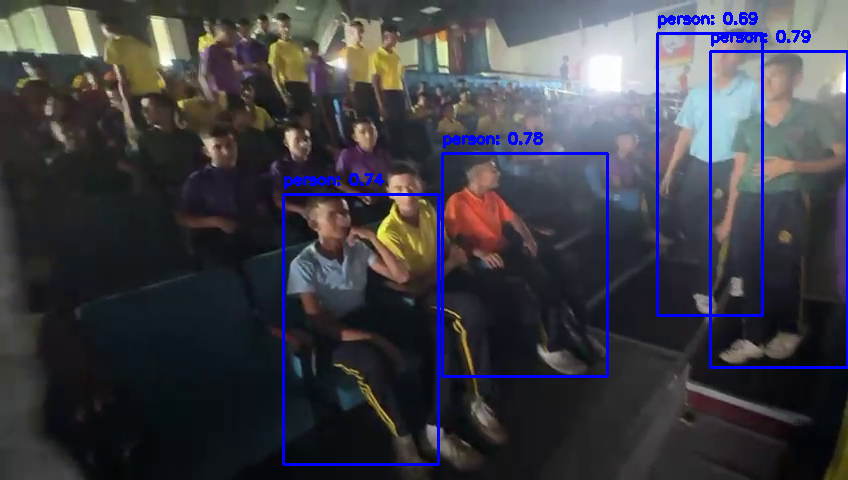


0: 384x640 5 persons, 265.3ms
Speed: 5.1ms preprocess, 265.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


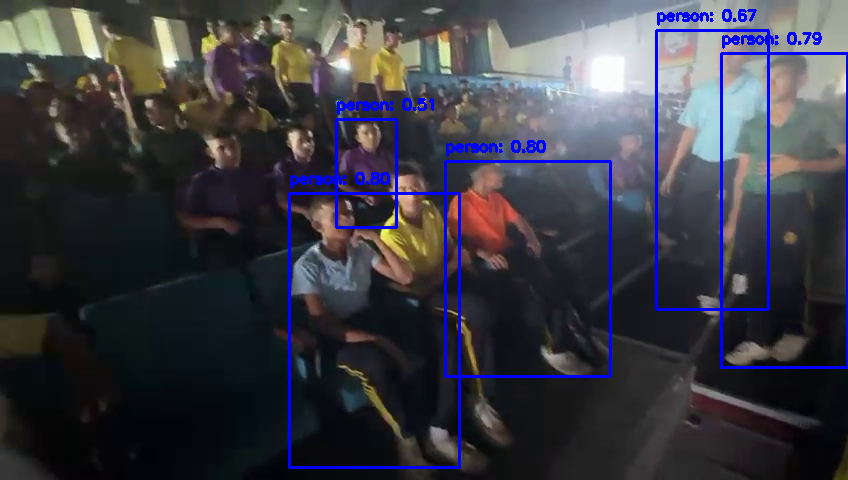


0: 384x640 4 persons, 250.1ms
Speed: 7.3ms preprocess, 250.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


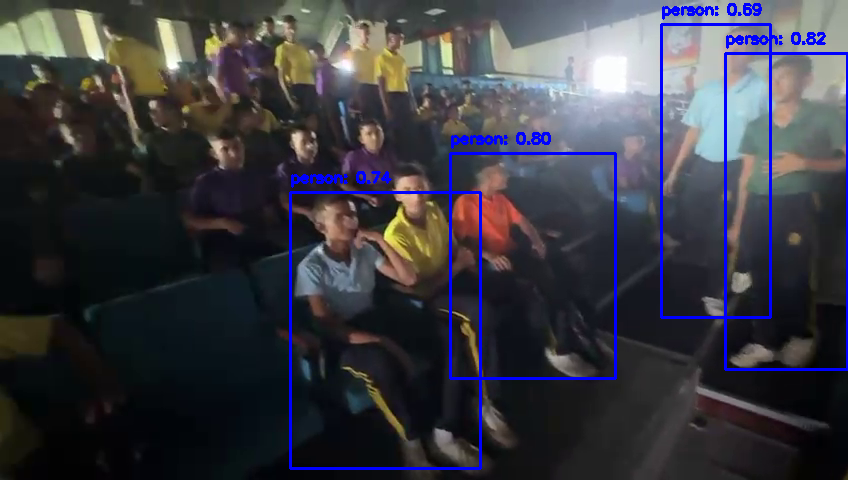


0: 384x640 4 persons, 238.2ms
Speed: 5.3ms preprocess, 238.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


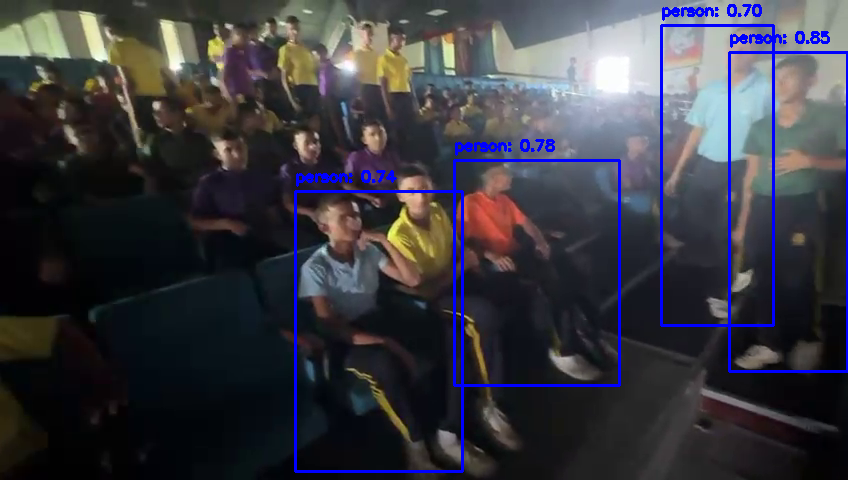


0: 384x640 4 persons, 222.2ms
Speed: 5.0ms preprocess, 222.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


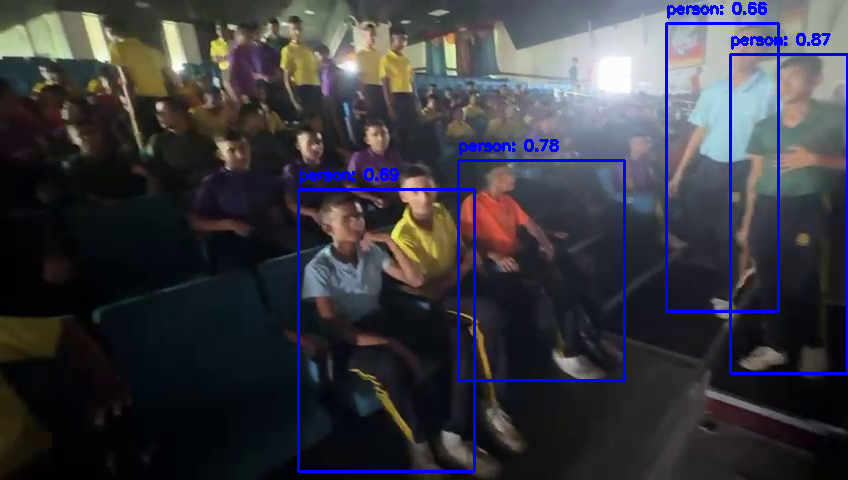


0: 384x640 4 persons, 208.4ms
Speed: 5.1ms preprocess, 208.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


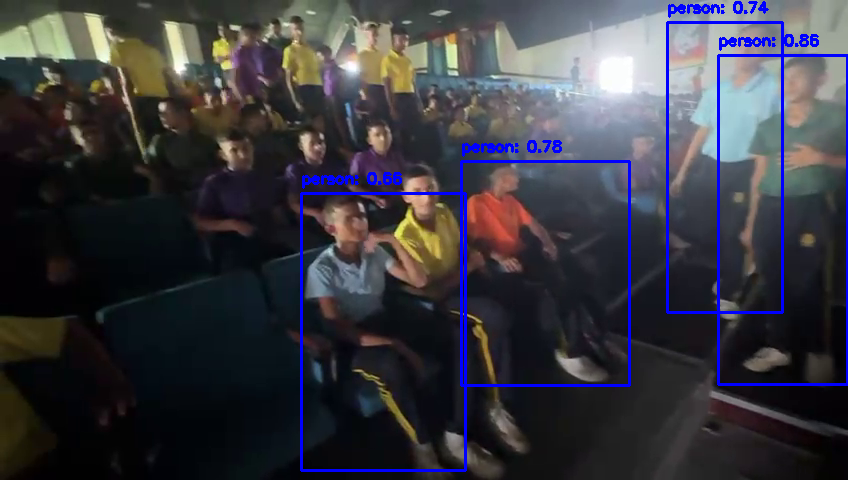


0: 384x640 4 persons, 238.8ms
Speed: 5.1ms preprocess, 238.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


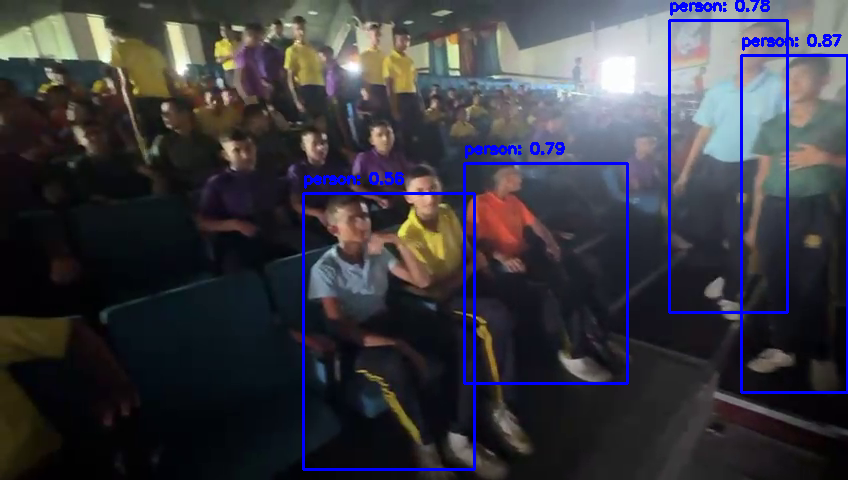


0: 384x640 5 persons, 225.3ms
Speed: 6.8ms preprocess, 225.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


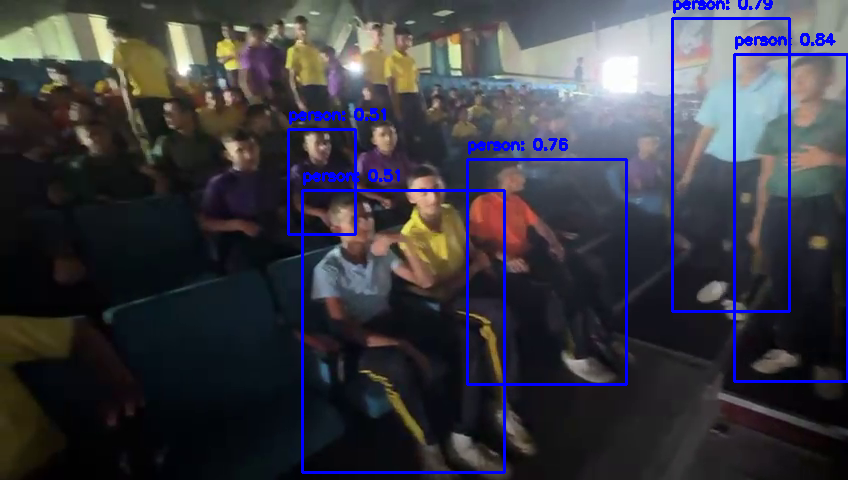

Video saved to output_video.avi


In [12]:
run_video_demo()

# **Result**

**Video Detection**

**Processed Video:** Displays the video with real-time object detection.

**Output File:** Saves the processed video as output_video.avi.

# **Conclusion**
This project successfully implemented an object detection system using the YOLOv8 model in Python. By leveraging powerful libraries like PyTorch and OpenCV, the system efficiently detects and highlights objects in both images and videos. The ability to utilize GPU acceleration significantly improves the performance, making the application suitable for real-time detection tasks. The user-friendly interface ensures that users can easily upload media files and view the results without any technical complexities.

# **Future Work**
**Real-Time Detection:** Enhance the system to perform real-time object detection using live camera feeds.

**Model Optimization:** Experiment with different YOLOv8 variants (e.g., small, medium) to balance accuracy and speed.

**User Interface Improvements:** Develop a graphical user interface (GUI) for a more seamless user experience.

**Additional Features:** Incorporate functionalities like object tracking and classification.


# **References**
**Ultralytics YOLOv8 Documentation:** https://docs.ultralytics.com/

**PyTorch Documentation:** https://pytorch.org/docs/

**OpenCV Documentation:** https://docs.opencv.org/

**Matplotlib Documentation:** https://matplotlib.org/stable/contents.html

**Google Colab:** https://colab.research.google.com/
